In [1]:
#import required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('seaborn')
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score,accuracy_score,roc_auc_score
import lime
from lime.lime_tabular import LimeTabularExplainer

/var/folders/xy/8mmbysx15_14yh_fwlh_2gdr0000gn/T/ipykernel_4966/629457616.py:6: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


In [2]:
df = pd.read_csv('/Users/user/Downloads/diabetes+130-us+hospitals+for+years+1999-2008/diabetic_data.csv')
df.replace('?',np.nan,inplace=True)
df.head()

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
1,149190,55629189,Caucasian,Female,[10-20),NaN,1,1,7,3,...,No,Up,No,No,No,No,No,Ch,Yes,>30
2,64410,86047875,AfricanAmerican,Female,[20-30),NaN,1,1,7,2,...,No,No,No,No,No,No,No,No,Yes,NO
3,500364,82442376,Caucasian,Male,[30-40),NaN,1,1,7,2,...,No,Up,No,No,No,No,No,Ch,Yes,NO
4,16680,42519267,Caucasian,Male,[40-50),NaN,1,1,7,1,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


In [3]:

# libraries for models
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# libraries for data processing
from sklearn import preprocessing
from sklearn.model_selection import train_test_split

# libraries for metrics of models
from sklearn.metrics import (
    accuracy_score, confusion_matrix,
    roc_curve, auc, roc_auc_score,
    plot_confusion_matrix,
    classification_report,
    balanced_accuracy_score,
    PrecisionRecallDisplay)

from sklearn.model_selection import GroupKFold
from sklearn.model_selection import cross_val_score

# libraries for fairness
from fairlearn.metrics import MetricFrame
from fairlearn.postprocessing import ThresholdOptimizer


from fairlearn.metrics import (
    MetricFrame,
    selection_rate, 
    demographic_parity_difference, 
    demographic_parity_ratio,
    false_positive_rate, 
    false_negative_rate,
    false_positive_rate_difference, 
    false_negative_rate_difference, 
    true_positive_rate, 
    true_negative_rate,
    selection_rate,
    count,
    equalized_odds_difference)
     
    

    


In [4]:
def get_metrics_df(models_dict, y_true, group):
    metrics_dict = {
        "Equalized_odds_difference": (
            lambda x: equalized_odds_difference(y_true, x, sensitive_features=group), True),
        "False negative rate difference": (
            lambda x: false_negative_rate_difference(y_true, x, sensitive_features=group), True),
        "Balanced error rate difference": (
            lambda x: MetricFrame(metrics=balanced_accuracy_score, y_true=y_true, y_pred=x, sensitive_features=group).difference(method='between_groups'), True),
        "Demographic parity difference": (
            lambda x: demographic_parity_difference(y_true, x, sensitive_features=group), True),
        "  ------": (lambda x: "", True),
        "Overall AUC": (
            lambda x: roc_auc_score(y_true, x), False),
        "AUC difference": (
            lambda x: MetricFrame(metrics=roc_auc_score, y_true=y_true, y_pred=x, sensitive_features=group).difference(method='between_groups'), False),
    }
    df_dict = {}
    for metric_name, (metric_func, use_preds) in metrics_dict.items():
        df_dict[metric_name] = [metric_func(preds) if use_preds else metric_func(scores) 
                                for model_name, (preds, scores) in models_dict.items()]
    return pd.DataFrame.from_dict(df_dict, orient="index", columns=models_dict.keys())


def metric_frame (feature):
    mf = MetricFrame({
        'FPR': false_positive_rate,
        'FNR': false_negative_rate,
        'TPR': true_positive_rate,
        'TNR': true_negative_rate, },
        y_test, test_preds, sensitive_features = feature)
    return mf.by_group


def summary_as_df(name, summary):
    a = summary.by_group
    a['overall'] = summary.overall
    return pd.DataFrame({name: a})

In [5]:

# define for the metric frame
metrics = {
    'accuracy': accuracy_score,
    'false positive rate': false_positive_rate,
    'false negative rate': false_negative_rate,
    'selection rate': selection_rate,
    'count': count,
    'balanced error rate': balanced_accuracy_score}


In [6]:
encounter_counts_diag1 = df['diag_1'].value_counts().reset_index()
encounter_counts_diag1.columns = ['ICD-9 Code', 'Number of Encounters']

In [7]:
# Filtering by Diagnosis (ICD9 Codes 250-251)
# Ensure diag_1 is numeric or convert it
df['diag_1'] = pd.to_numeric(df['diag_1'], errors='coerce')
diabetes_diag_df = df[(df['diag_1'] >= 250) & (df['diag_1'] < 252)]

# Filtering by Diabetes Medication
diabetes_med_df = df[df['diabetesMed'] == 'Yes']

# Check the number of data points
print("Number of data points with diabetes diagnosis:", len(diabetes_diag_df))
print("Number of data points with diabetes medication:", len(diabetes_med_df))

Number of data points with diabetes diagnosis: 8772
Number of data points with diabetes medication: 78363


In [8]:
diabetes_diag_df

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,...,No,No,No,No,No,No,No,No,No,NO
10,28236,89869032,AfricanAmerican,Female,[40-50),NaN,1,1,7,9,...,No,Steady,No,No,No,No,No,No,Yes,>30
52,590346,37746639,AfricanAmerican,Female,[40-50),NaN,1,6,7,8,...,No,Steady,No,No,No,No,No,No,Yes,>30
56,630342,93232917,AfricanAmerican,Female,[50-60),NaN,3,6,2,9,...,No,Steady,No,No,No,No,No,No,Yes,>30
60,676422,63754317,AfricanAmerican,Female,[70-80),NaN,1,1,7,4,...,No,Steady,No,No,No,No,No,No,Yes,>30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101728,443710592,84391839,Caucasian,Female,[30-40),NaN,1,1,7,5,...,No,No,No,No,No,No,No,No,Yes,>30
101731,443724206,124767527,Caucasian,Male,[50-60),NaN,1,1,7,4,...,No,Up,No,No,No,No,No,Ch,Yes,NO
101742,443787512,52419276,Caucasian,Male,[70-80),NaN,2,6,2,4,...,No,Steady,No,No,No,No,No,Ch,Yes,NO
101753,443841992,184875899,Other,Male,[40-50),NaN,1,1,7,13,...,No,Down,No,No,No,No,No,Ch,Yes,NO


In [9]:
diabetes_diag_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8772 entries, 0 to 101761
Data columns (total 50 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   encounter_id              8772 non-null   int64  
 1   patient_nbr               8772 non-null   int64  
 2   race                      8582 non-null   object 
 3   gender                    8772 non-null   object 
 4   age                       8772 non-null   object 
 5   weight                    217 non-null    object 
 6   admission_type_id         8772 non-null   int64  
 7   discharge_disposition_id  8772 non-null   int64  
 8   admission_source_id       8772 non-null   int64  
 9   time_in_hospital          8772 non-null   int64  
 10  payer_code                5197 non-null   object 
 11  medical_specialty         4583 non-null   object 
 12  num_lab_procedures        8772 non-null   int64  
 13  num_procedures            8772 non-null   int64  
 14  num_me

In [10]:
# Created another column and take it as 2 class problem, Label the <30 and >30 as YES and Other "N0" as No.

def check_label(text):
    if text == '>30' or text =='<30':
        return 'Yes'
    else:
        return 'No'
    
diabetes_diag_df['readmitted_2'] =diabetes_diag_df['readmitted'].apply(check_label) 

In [11]:
diabetes_diag_df.loc[diabetes_diag_df['race'] == '?', 'race'] = 'Other'

In [12]:
diabetes_diag_df['gender'].value_counts()

Male      4454
Female    4318
Name: gender, dtype: int64

In [13]:
diabetes_diag_df[diabetes_diag_df['gender']!='Unknown/Invalid']

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted,readmitted_2
0,2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,...,No,No,No,No,No,No,No,No,NO,No
10,28236,89869032,AfricanAmerican,Female,[40-50),NaN,1,1,7,9,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
52,590346,37746639,AfricanAmerican,Female,[40-50),NaN,1,6,7,8,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
56,630342,93232917,AfricanAmerican,Female,[50-60),NaN,3,6,2,9,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
60,676422,63754317,AfricanAmerican,Female,[70-80),NaN,1,1,7,4,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101728,443710592,84391839,Caucasian,Female,[30-40),NaN,1,1,7,5,...,No,No,No,No,No,No,No,Yes,>30,Yes
101731,443724206,124767527,Caucasian,Male,[50-60),NaN,1,1,7,4,...,Up,No,No,No,No,No,Ch,Yes,NO,No
101742,443787512,52419276,Caucasian,Male,[70-80),NaN,2,6,2,4,...,Steady,No,No,No,No,No,Ch,Yes,NO,No
101753,443841992,184875899,Other,Male,[40-50),NaN,1,1,7,13,...,Down,No,No,No,No,No,Ch,Yes,NO,No


In [14]:
# Drop the "Unknown/Invalid" gender of the data.
diabetes_diag_df.drop(diabetes_diag_df[diabetes_diag_df['gender'] == 'Unknown/Invalid'].index, inplace = True)

In [15]:
diabetes_diag_df.reset_index(inplace = True, drop = True)

In [16]:
diabetes_diag_df.head()

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted,readmitted_2
0,2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,...,No,No,No,No,No,No,No,No,NO,No
1,28236,89869032,AfricanAmerican,Female,[40-50),NaN,1,1,7,9,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
2,590346,37746639,AfricanAmerican,Female,[40-50),NaN,1,6,7,8,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
3,630342,93232917,AfricanAmerican,Female,[50-60),NaN,3,6,2,9,...,Steady,No,No,No,No,No,No,Yes,>30,Yes
4,676422,63754317,AfricanAmerican,Female,[70-80),NaN,1,1,7,4,...,Steady,No,No,No,No,No,No,Yes,>30,Yes


In [17]:
# Check the distribution of 'race' groups
race_distribution = diabetes_diag_df['race'].value_counts()
print("Race distribution:\n", race_distribution)

Race distribution:
 Caucasian          5700
AfricanAmerican    2496
Hispanic            218
Other               133
Asian                35
Name: race, dtype: int64


In [18]:
# Lets drop this column. 
diabetes_diag_df.drop(columns = ['weight'], inplace = True)

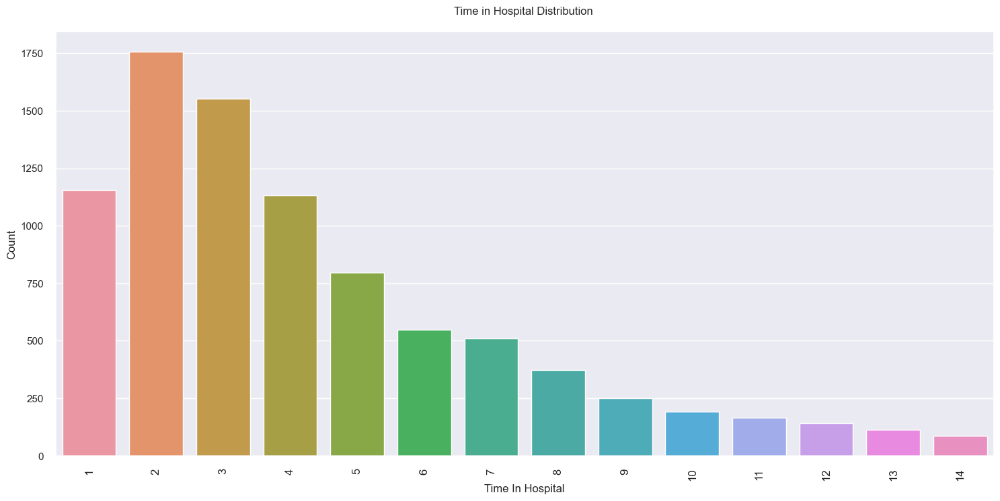

In [19]:
sns.set(rc={'figure.figsize':(18,8.2)})
ax = sns.countplot(x='time_in_hospital',   data= diabetes_diag_df)
plt.xlabel('Time In Hospital', size = 12)
plt.xticks(rotation=90, size = 12)
plt.ylabel('Count', size = 12)
plt.title('Time in Hospital Distribution \n', size = 12)
plt.show()

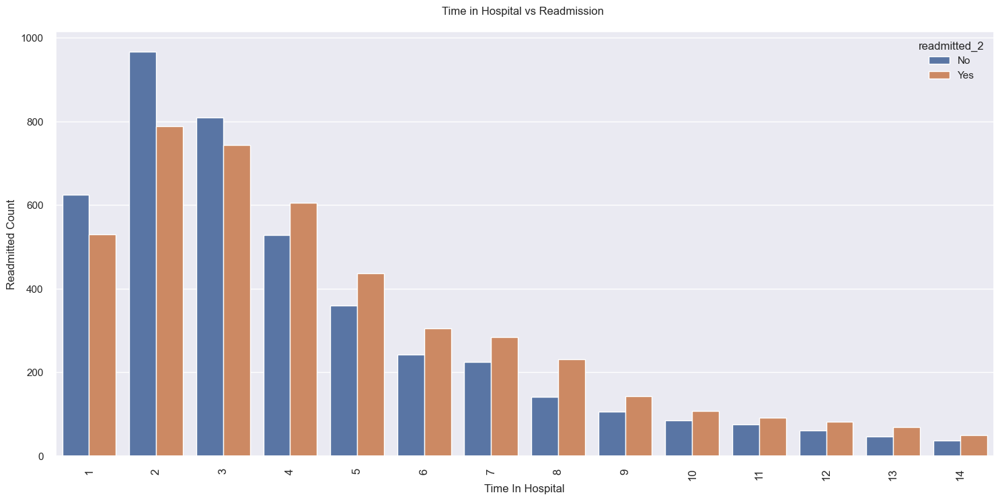

In [20]:
sns.set(rc={'figure.figsize':(18,8.2)})
ax = sns.countplot(x='time_in_hospital',  hue= 'readmitted_2',  data= diabetes_diag_df)
plt.xlabel('Time In Hospital', size = 12)
plt.xticks(rotation=90, size = 12)
plt.ylabel('Readmitted Count', size = 12)
plt.title('Time in Hospital vs Readmission \n', size = 12)
plt.show()

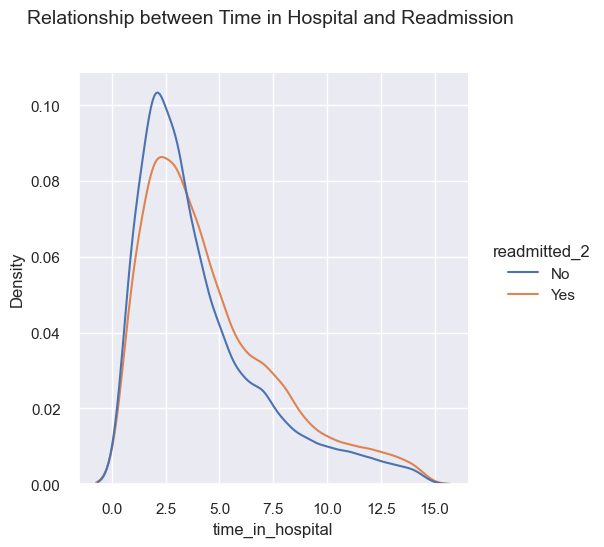

In [21]:
sns.set(rc={'figure.figsize':(18, 8.2)})
sns.displot(diabetes_diag_df, x="time_in_hospital", hue = 'readmitted_2', kind="kde")
plt.title('Relationship between Time in Hospital and Readmission \n\n', size  = 14)
plt.show()

In [22]:
diabetes_diag_df.drop(columns = ['payer_code'], inplace = True)

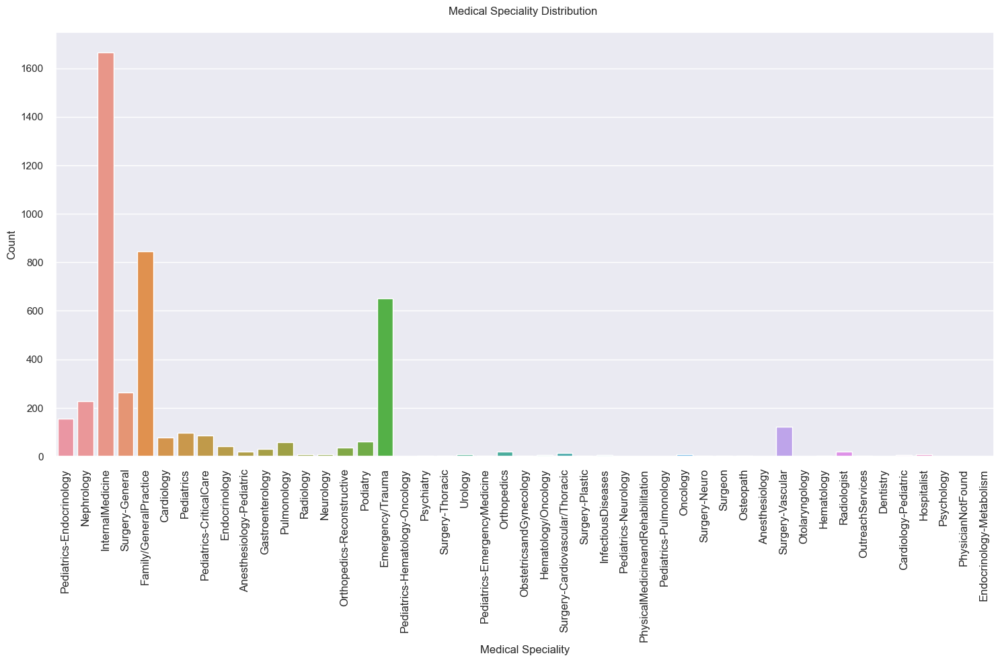

In [23]:
sns.set(rc={'figure.figsize':(18,8.2)})
ax = sns.countplot(x='medical_specialty',   data= diabetes_diag_df)
plt.xlabel('Medical Speciality', size = 12)
plt.xticks(rotation=90, size = 12)
plt.ylabel('Count', size = 12)
plt.title('Medical Speciality Distribution \n', size = 12)
plt.show()

In [24]:
diabetes_diag_df.drop(columns =['medical_specialty'], inplace = True)

In [25]:
diabetes_diag_df.drop(columns = ['acetohexamide', 'tolbutamide', 'troglitazone', 'tolazamide', 'examide', 'citoglipton',
                   'glipizide-metformin', 'glimepiride-pioglitazone', 'metformin-rosiglitazone',
                   'metformin-pioglitazone'], inplace = True)

In [26]:
diabetes_diag_df.shape

(8772, 38)

In [27]:
# Make copy of data.
diabetes_diag_df_ = diabetes_diag_df.copy()

In [28]:
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
le = LabelEncoder()

In [29]:
categorical_features =['race', 'gender', 'age',
       'admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'diag_1', 'diag_2', 'diag_3', 'number_diagnoses',
       'max_glu_serum', 'A1Cresult', 'metformin', 'repaglinide', 'nateglinide',
       'chlorpropamide', 'glimepiride', 'glipizide', 'glyburide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'insulin',
       'glyburide-metformin', 'change', 'diabetesMed'] 

for i in categorical_features:
    diabetes_diag_df_[i] = le.fit_transform(diabetes_diag_df_[i])

In [30]:
diabetes_diag_df_.head()

,encounter_id,patient_nbr,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,...,pioglitazone,rosiglitazone,acarbose,miglitol,insulin,glyburide-metformin,change,diabetesMed,readmitted,readmitted_2
0,2278392,8222157,2,0,0,5,18,0,1,41,...,1,1,0,0,1,1,1,0,NO,No
1,28236,89869032,0,0,4,0,0,6,9,47,...,1,1,0,0,2,1,1,1,>30,Yes
2,590346,37746639,0,0,4,0,5,6,8,55,...,1,1,0,0,2,1,1,1,>30,Yes
3,630342,93232917,0,0,5,2,5,1,9,37,...,1,1,0,0,2,1,1,1,>30,Yes
4,676422,63754317,0,0,7,0,0,6,4,48,...,1,1,0,0,2,1,1,1,>30,Yes


In [31]:
label = le.fit(diabetes_diag_df_['readmitted_2'])

In [32]:
diabetes_diag_df_['readmitted_2_encoded'] = label.transform(diabetes_diag_df_['readmitted_2'])

In [33]:
diabetes_diag_df_ = diabetes_diag_df_.drop(columns= ['encounter_id', 'patient_nbr', 'readmitted','readmitted_2'])

In [34]:
diabetes_diag_df_

,race,gender,age,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,num_lab_procedures,num_procedures,num_medications,...,glyburide,pioglitazone,rosiglitazone,acarbose,miglitol,insulin,glyburide-metformin,change,diabetesMed,readmitted_2_encoded
0,2,0,0,5,18,0,1,41,0,1,...,1,1,1,0,0,1,1,1,0,0
1,0,0,4,0,0,6,9,47,2,17,...,1,1,1,0,0,2,1,1,1,1
2,0,0,4,0,5,6,8,55,2,17,...,1,1,1,0,0,2,1,1,1,1
3,0,0,5,2,5,1,9,37,2,19,...,1,1,1,0,0,2,1,1,1,1
4,0,0,7,0,0,6,4,48,2,15,...,1,1,1,0,0,2,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8767,2,0,3,0,0,6,5,47,0,31,...,1,1,1,0,0,1,1,1,1,1
8768,2,1,5,0,0,6,4,29,0,16,...,1,1,1,0,0,3,1,0,1,0
8769,2,1,7,1,5,1,4,43,0,10,...,1,1,1,0,0,2,1,0,1,0
8770,4,1,4,0,0,6,13,51,2,13,...,1,1,1,0,0,0,1,0,1,0


In [35]:
# Check the distribution of 'race' groups
race_distribution = diabetes_diag_df_['race'].value_counts()
print("Race distribution:\n", race_distribution)

Race distribution:
 2    5700
0    2496
3     218
5     190
4     133
1      35
Name: race, dtype: int64


In [36]:
diabetes_diag_df_ = diabetes_diag_df_[diabetes_diag_df_['race'] != 5]

In [37]:
diabetes_diag_df_[['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 
   'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses']].corr()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
time_in_hospital,1.000000,0.231655,0.492201,0.591973,0.030815,-0.029507,0.052996,0.320818
num_lab_procedures,0.231655,1.000000,0.074318,0.246859,-0.022066,-0.033237,-0.002749,0.065057
num_procedures,0.492201,0.074318,1.000000,0.512839,0.049833,-0.022978,0.012015,0.294910
num_medications,0.591973,0.246859,0.512839,1.000000,0.117495,0.032199,0.122560,0.467998
number_outpatient,0.030815,-0.022066,0.049833,0.117495,1.000000,0.093508,0.122984,0.137827
number_emergency,-0.029507,-0.033237,-0.022978,0.032199,0.093508,1.000000,0.355824,0.084302
number_inpatient,0.052996,-0.002749,0.012015,0.122560,0.122984,0.355824,1.000000,0.102858
number_diagnoses,0.320818,0.065057,0.294910,0.467998,0.137827,0.084302,0.102858,1.000000


In [38]:
diabetes_diag_df_.columns

Index(['race', 'gender', 'age', 'admission_type_id',
       'discharge_disposition_id', 'admission_source_id', 'time_in_hospital',
       'num_lab_procedures', 'num_procedures', 'num_medications',
       'number_outpatient', 'number_emergency', 'number_inpatient', 'diag_1',
       'diag_2', 'diag_3', 'number_diagnoses', 'max_glu_serum', 'A1Cresult',
       'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide',
       'glimepiride', 'glipizide', 'glyburide', 'pioglitazone',
       'rosiglitazone', 'acarbose', 'miglitol', 'insulin',
       'glyburide-metformin', 'change', 'diabetesMed', 'readmitted_2_encoded'],
      dtype='object')

In [39]:
# List of columns to keep
columns_to_keep = [
    'readmitted_2_encoded', 'num_lab_procedures', 'num_medications', 'diag_2', 'diag_3', 
    'diag_1', 'time_in_hospital', 'age', 'discharge_disposition_id', 'number_inpatient', 
    'number_diagnoses', 'num_procedures', 'insulin', 'admission_type_id', 
    'admission_source_id', 'race', 'number_outpatient', 'A1Cresult', 'gender', 
    'metformin', 'glipizide', 'glyburide', 'change', 'number_emergency', 'diabetesMed'
]

# Keeping only the specified columns
diabetes_diag_df_ = diabetes_diag_df_[columns_to_keep]


# CLASSIFIERS ARE NOW TRAINED ON TOP 24 FEATURES ONLY

In [40]:
diabetes_diag_df_

,readmitted_2_encoded,num_lab_procedures,num_medications,diag_2,diag_3,diag_1,time_in_hospital,age,discharge_disposition_id,number_inpatient,...,race,number_outpatient,A1Cresult,gender,metformin,glipizide,glyburide,change,number_emergency,diabetesMed
0,0,41,1,347,404,29,1,0,18,0,...,2,0,2,0,1,1,1,1,0,0
1,1,47,17,129,358,25,9,4,0,0,...,0,0,2,0,1,1,1,1,0,1
2,1,55,17,254,262,24,8,4,5,0,...,0,0,2,0,1,1,1,1,0,1
3,1,37,19,151,144,25,9,5,5,1,...,0,0,2,0,1,1,1,1,0,1
4,1,48,15,338,144,16,4,7,0,0,...,0,0,2,0,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8767,1,47,31,270,274,28,5,3,0,2,...,2,0,1,0,2,1,1,1,0,1
8768,0,29,16,59,69,0,4,5,0,0,...,2,0,2,1,2,1,1,0,0,1
8769,0,43,10,244,346,26,4,7,5,0,...,2,0,1,1,1,3,1,0,0,1
8770,0,51,13,270,294,26,13,4,0,0,...,4,0,2,1,2,1,1,0,0,1


In [41]:
# Split the adjusted dataset into training and testing sets
X = diabetes_diag_df_.drop(columns=['readmitted_2_encoded'])
y = diabetes_diag_df_['readmitted_2_encoded']
A = diabetes_diag_df_['race']

X_train, X_test, y_train, y_test, A_train, A_test = train_test_split(
    X, 
    y, 
    A, 
    test_size=0.20, 
    random_state=42)

In [42]:
from imblearn.over_sampling import SMOTE  # Import SMOTE
from collections import Counter  # Import Counter from collections module

# Initialize a Counter to count the class distribution before applying SMOTE
counter_before = Counter(y_train)

# Print the class distribution before
print('Before SMOTE:', counter_before)

# Now, let's check the race distribution in the original data
race_counts_original = X_train['race'].value_counts()
print(race_counts_original)

# Initialize SMOTE with a random state
smote = SMOTE(random_state=139)

# Apply SMOTE to oversample
X_train, y_train = smote.fit_resample(X_train, y_train)

# Initialize a Counter to count the class distribution after applying SMOTE
counter_after = Counter(y_train)

# Print the class distribution after
print('After SMOTE:', counter_after)

# Now, let's check the race distribution in the resampled data
race_counts_resampled = X_train['race'].value_counts()
print(race_counts_resampled)


Before SMOTE: Counter({1: 3521, 0: 3344})
2    4550
0    2012
3     169
4     106
1      28
Name: race, dtype: int64
After SMOTE: Counter({1: 3521, 0: 3521})
2    4628
0    2071
3     173
4     106
1      64
Name: race, dtype: int64


In [43]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import plot_confusion_matrix, plot_precision_recall_curve

In [44]:
from sklearn.ensemble import RandomForestClassifier
rf_bal_sub = RandomForestClassifier(n_estimators = 450, max_depth=9, random_state=43, class_weight='balanced_subsample')


In [45]:
rf_bal = RandomForestClassifier(n_estimators = 450, max_depth=9, random_state=43, class_weight='balanced')


In [46]:
# set up model:
classifiers = [
               rf_bal_sub,
              rf_bal]

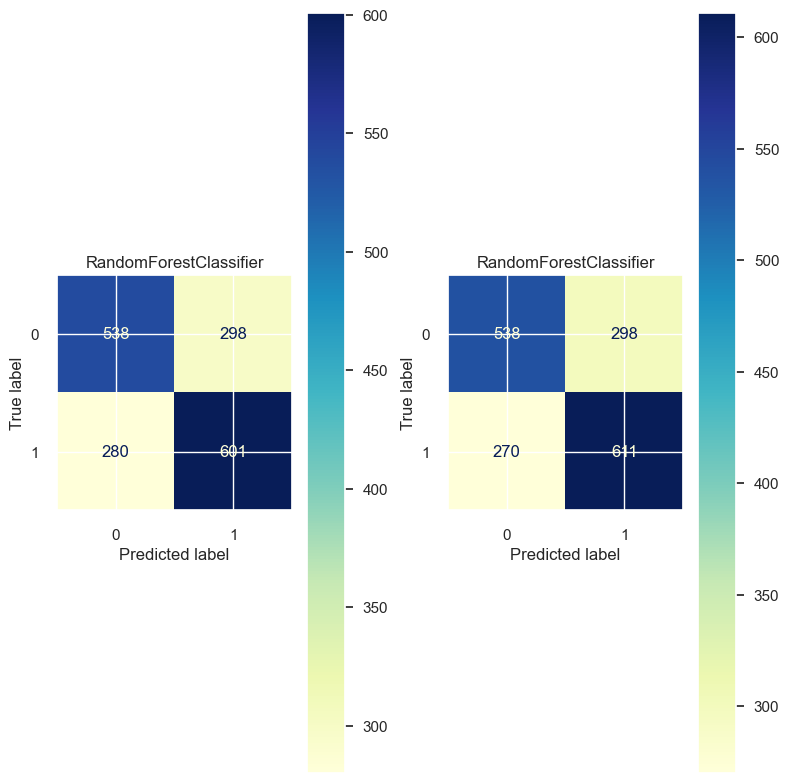

In [47]:
# test set
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 8))

for cls, ax in zip(classifiers, axes.flatten()):
    cls.fit(X_train, y_train)
    plot_confusion_matrix(cls, 
                          X_test, 
                          y_test, 
                          ax=ax, 
                          cmap='YlGnBu')
    ax.title.set_text(type(cls).__name__)
plt.tight_layout()
plt.show()

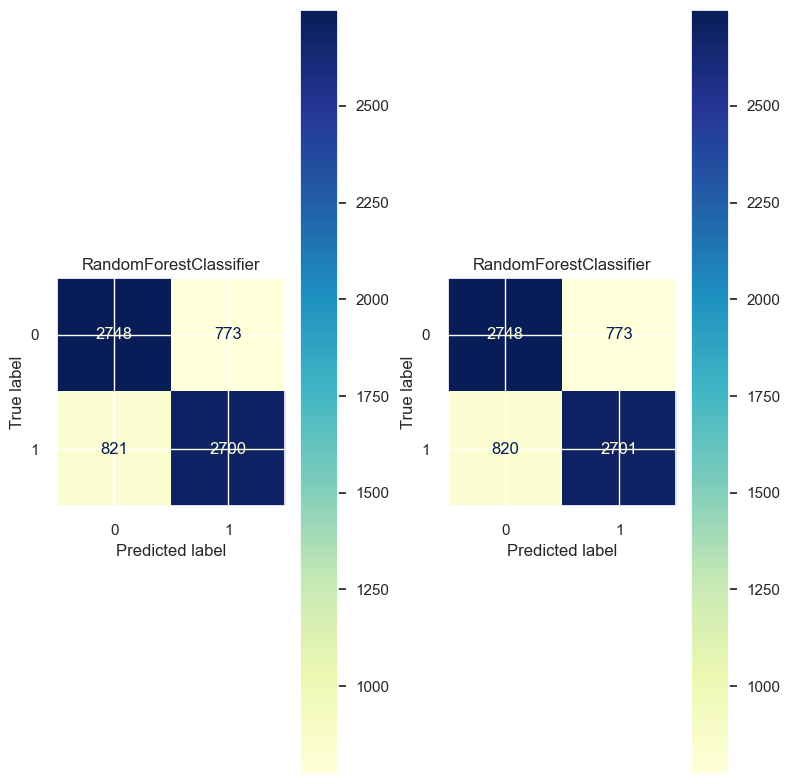

In [48]:
# double check with train set
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 8))

for cls, ax in zip(classifiers, axes.flatten()):
    cls.fit(X_train, y_train)
    plot_confusion_matrix(cls, 
                          X_train, 
                          y_train, 
                          
                          ax=ax, 
                          cmap='YlGnBu')
    ax.title.set_text(type(cls).__name__)
plt.tight_layout()
plt.show()

In [49]:
for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)
  print(f'{model}: {chr(10)} {classification_report(y_test, y_pred)}') 

RandomForestClassifier(class_weight='balanced_subsample', max_depth=9,
                       n_estimators=450, random_state=43): 
               precision    recall  f1-score   support

           0       0.66      0.64      0.65       836
           1       0.67      0.68      0.68       881

    accuracy                           0.66      1717
   macro avg       0.66      0.66      0.66      1717
weighted avg       0.66      0.66      0.66      1717

RandomForestClassifier(class_weight='balanced', max_depth=9, n_estimators=450,
                       random_state=43): 
               precision    recall  f1-score   support

           0       0.67      0.64      0.65       836
           1       0.67      0.69      0.68       881

    accuracy                           0.67      1717
   macro avg       0.67      0.67      0.67      1717
weighted avg       0.67      0.67      0.67      1717



In [50]:
from sklearn.model_selection import cross_val_predict, StratifiedKFold
from sklearn.metrics import classification_report, roc_auc_score



classifier_names = ["RF BALANCE SUBSAMPLE WEIGHTS", "BALANCED RF", "RF BALANCED WEIGHTS"]

# Define the number of splits for cross-validation
n_splits = 4

# Loop over classifiers
for model, classifier_name in zip(classifiers, classifier_names):
    print(f"Evaluating {classifier_name}:")
    
    # Initialize lists to store classification reports and AUC scores
    classification_reports = []
    auc_scores = []
    
    # Perform cross-validation
    for train_index, test_index in StratifiedKFold(n_splits=n_splits).split(X_test, y_test):
        X_train_cv, X_test_cv = X_test.iloc[train_index], X_test.iloc[test_index]
        y_train_cv, y_test_cv = y_test.iloc[train_index], y_test.iloc[test_index]

        # Fit the model on the training data
        model.fit(X_train_cv, y_train_cv)

        # Make predictions on the test data
        y_pred_cv = model.predict(X_test_cv)

        # Predict probabilities for the 'Readmitted' class
        y_probs_cv = model.predict_proba(X_test_cv)[:, 1]

        # Compute the ROC-AUC score
        auc_cv = roc_auc_score(y_test_cv, y_probs_cv)
        auc_scores.append(auc_cv)

        # Generate and store the classification report
        report_cv = classification_report(y_test_cv, y_pred_cv, target_names=['Not Readmitted', 'Readmitted'], output_dict=True)
        classification_reports.append(report_cv)

    # Calculate the average AUC score across cross-validation folds
    avg_auc_score = sum(auc_scores) / len(auc_scores)
    
    # Calculate the average classification report across cross-validation folds
    avg_classification_report = {}
    for label in ['Not Readmitted', 'Readmitted']:
        avg_classification_report[label] = {
            'precision': sum(report[label]['precision'] for report in classification_reports) / len(classification_reports),
            'recall': sum(report[label]['recall'] for report in classification_reports) / len(classification_reports),
            'f1-score': sum(report[label]['f1-score'] for report in classification_reports) / len(classification_reports),
            'support': int(sum(report[label]['support'] for report in classification_reports) / len(classification_reports))
        }

    # Format and print the results
    print("Average Classification Report Aware of Race:")
    for label in avg_classification_report:
        print(f"{label}:")
        for metric in avg_classification_report[label]:
            print(f"{metric}: {avg_classification_report[label][metric]:.2f}")
        print()
    print(f"Average AUC Score: {avg_auc_score:.2f}")
    print("\n")

Evaluating RF BALANCE SUBSAMPLE WEIGHTS:
Average Classification Report Aware of Race:
Not Readmitted:
precision: 0.64
recall: 0.63
f1-score: 0.63
support: 209.00

Readmitted:
precision: 0.65
recall: 0.66
f1-score: 0.66
support: 220.00

Average AUC Score: 0.71


Evaluating BALANCED RF:
Average Classification Report Aware of Race:
Not Readmitted:
precision: 0.63
recall: 0.64
f1-score: 0.64
support: 209.00

Readmitted:
precision: 0.66
recall: 0.65
f1-score: 0.65
support: 220.00

Average AUC Score: 0.71




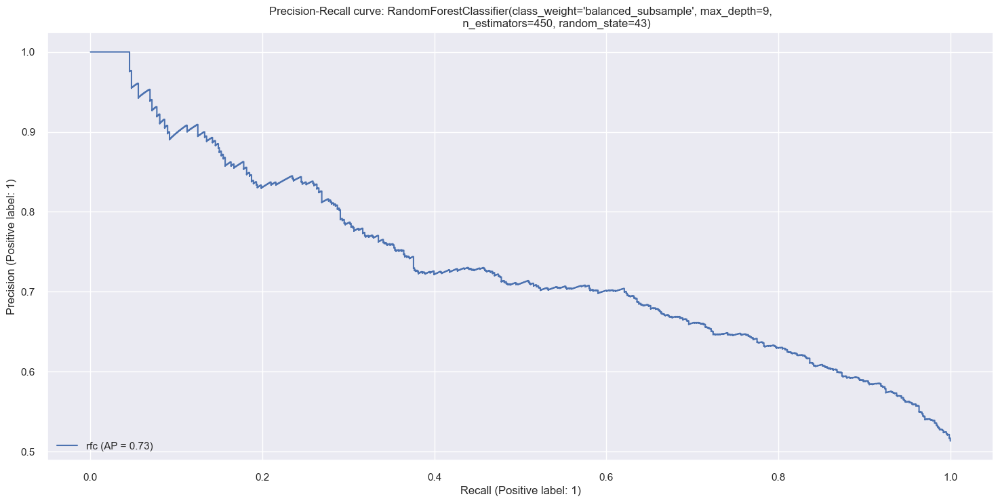

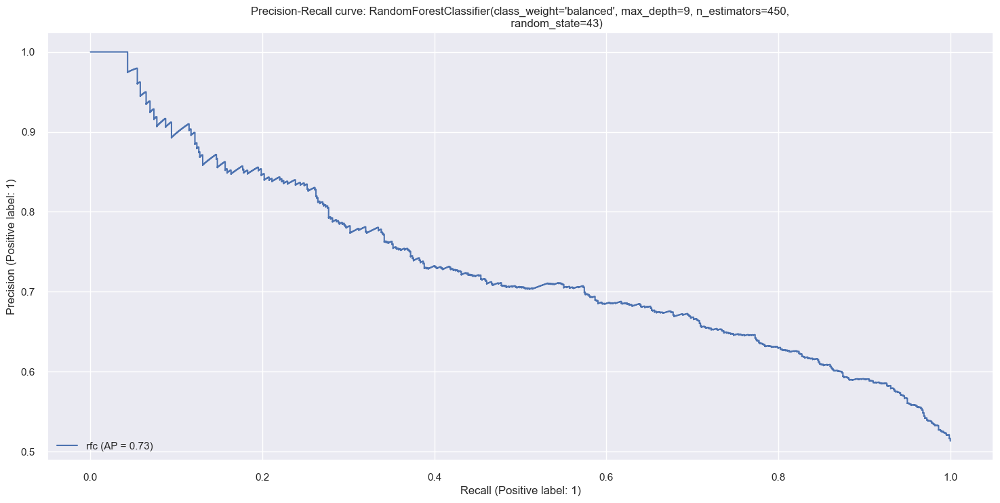

In [51]:
for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)
  display = PrecisionRecallDisplay.from_estimator(model, X_test, y_test, name="rfc")
  _ = display.ax_.set_title(f'Precision-Recall curve: {model}')   

In [52]:
# define sensitive attributes
race =  A_test


for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  # scores on test set
  y_pred = model.predict_proba(X_test)[:, 1]

  # predictions (0 or 1) on test set
  test_preds = (y_pred >= np.mean(y_train)) * 1

  print(f'Race:{chr(10)}{model}: {chr(10)} {metric_frame (race)} {chr(10)}')

Race:
RandomForestClassifier(class_weight='balanced_subsample', max_depth=9,
                       n_estimators=450, random_state=43): 
            FPR       FNR       TPR       TNR
race                                        
0     0.253906  0.385965  0.614035  0.746094
1     0.333333  0.000000  1.000000  0.666667
2     0.402622  0.292208  0.707792  0.597378
3     0.321429  0.238095  0.761905  0.678571
4     0.583333  0.466667  0.533333  0.416667 

Race:
RandomForestClassifier(class_weight='balanced', max_depth=9, n_estimators=450,
                       random_state=43): 
            FPR       FNR       TPR       TNR
race                                        
0     0.257812  0.394737  0.605263  0.742188
1     0.333333  0.000000  1.000000  0.666667
2     0.400749  0.275974  0.724026  0.599251
3     0.321429  0.190476  0.809524  0.678571
4     0.583333  0.400000  0.600000  0.416667 



In [53]:
# Define sensitive attributes
race = A_test

# Initialize lists to store the differences
difference_race1_and_2 = []
difference_race3_and_2 = []

# Metrics 
for model in classifiers:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # scores on test set
    y_pred = model.predict_proba(X_test)[:, 1]

    # predictions (0 or 1) on test set
    test_preds = (y_pred >= np.mean(y_train)) * 1

    models_dict = {"Aware-Unmitigated": (test_preds, y_pred)}

    # Calculate the TPR for each race group
    tpr_race1 = metric_frame(race)["TPR"][1]  # TPR for race 1
    tpr_race2 = metric_frame(race)["TPR"][2]  # TPR for race 2
    tpr_race3 = metric_frame(race)["TPR"][3]  # TPR for race 5

    # Calculate and store the differences
    diff1_and_2 = tpr_race2 - tpr_race1
    diff3_and_2 = tpr_race2 - tpr_race3

    difference_race1_and_2.append(diff1_and_2)
    difference_race3_and_2.append(diff3_and_2)

    print(f'Race:{chr(10)}{model}: {chr(10)} {get_metrics_df(models_dict, y_test, race)} {chr(10)}') 

    # Calculate Equal Opportunity Differences for the current classifier
    eod_race1_and_2 = diff1_and_2
    eod_race3_and_2 = diff3_and_2

    print(f'Equal Opportunity Difference between Races Asian and Caucasian: {eod_race1_and_2}')
    print(f'Equal Opportunity Difference between Races Hispanic and Caucasian: {eod_race3_and_2}')

# Calculate the overall Equal Opportunity Differences between races 1 and 2 and between races 3 and 2
eod_race1_and_2_avg = sum(difference_race1_and_2) / len(difference_race1_and_2)
eod_race3_and_2_avg = sum(difference_race3_and_2) / len(difference_race3_and_2)

# Print the average Equal Opportunity Differences
print(f'Average Equal Opportunity Difference between Races Asian and Caucasian: {eod_race1_and_2_avg}')
print(f'Average Equal Opportunity Difference between Races Hispanic and Caucasian: {eod_race3_and_2_avg}')



Race:
RandomForestClassifier(class_weight='balanced_subsample', max_depth=9,
                       n_estimators=450, random_state=43): 
                                Aware-Unmitigated
Equalized_odds_difference               0.466667
False negative rate difference          0.466667
Balanced error rate difference          0.358333
Demographic parity difference           0.142533
  ------                                        
Overall AUC                               0.7244
AUC difference                          0.411111 

Equal Opportunity Difference between Races Asian and Caucasian: -0.29220779220779225
Equal Opportunity Difference between Races Hispanic and Caucasian: -0.05411255411255411
Race:
RandomForestClassifier(class_weight='balanced', max_depth=9, n_estimators=450,
                       random_state=43): 
                                Aware-Unmitigated
Equalized_odds_difference                    0.4
False negative rate difference               0.4
Balanced error rate 

In [54]:
import dalex as dx
from sklearn.pipeline import Pipeline


In [55]:
clf = Pipeline(steps=[
    ('classifier', rf_bal)
])

clf.fit(X, y)

Pipeline(steps=[('classifier',
                 RandomForestClassifier(class_weight='balanced', max_depth=9,
                                        n_estimators=450, random_state=43))])

In [56]:
exp = dx.Explainer(clf, X, y)


Preparation of a new explainer is initiated

  -> data              : 8582 rows 24 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 8582 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x15e9a2430> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.06, mean = 0.503, max = 0.941
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.791, mean = 0.00957, max = 0.873
  -> model_info        : package sklearn

A new explainer has been created!


In [57]:
exp.model_performance().result


,recall,precision,f1,accuracy,auc
RandomForestClassifier,0.760563,0.766308,0.763425,0.758215,0.841173


In [58]:
# Create a 'protected' array-like based on the 'race' column
protected = np.where(diabetes_diag_df_['race'] == 1, 'protected', np.where(diabetes_diag_df_['race'] == 2, 'privileged', 'other'))
privileged = 'privileged'

In [59]:
fobject = exp.model_fairness(protected = protected, privileged=privileged)


In [60]:
fobject.fairness_check(epsilon = 0.8) # default epsilon


Bias detected in 2 metrics: FPR, STP

Conclusion: your model is not fair because 2 or more criteria exceeded acceptable limits set by epsilon.

Ratios of metrics, based on 'privileged'. Parameter 'epsilon' was set to 0.8 and therefore metrics should be within (0.8, 1.25)
                TPR       ACC       PPV       FPR       STP
other      0.895674  0.997365  0.992188  0.720588  0.795247
protected  0.954198  1.054018  0.901042  0.639706  0.678245


In [61]:
# to see all scaled metric values you can run
fobject.result

,TPR,TNR,PPV,NPV,FNR,FPR,FDR,FOR,ACC,STP
other,0.895674,1.104396,0.992188,1.008032,1.383178,0.720588,1.025862,0.976285,0.997365,0.795247
privileged,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
protected,0.954198,1.134615,0.901042,1.156627,1.168224,0.639706,1.327586,0.537549,1.054018,0.678245


In [62]:
# or unscaled ones via
fobject.metric_scores

,TPR,TNR,PPV,NPV,FNR,FPR,FDR,FOR,ACC,STP
other,0.704,0.804,0.762,0.753,0.296,0.196,0.238,0.247,0.757,0.435
privileged,0.786,0.728,0.768,0.747,0.214,0.272,0.232,0.253,0.759,0.547
protected,0.750,0.826,0.692,0.864,0.250,0.174,0.308,0.136,0.800,0.371


In [63]:
fobject.plot()


Equal Opportunity Ratio: This metric looks at the ratio of true positives rates (TPR) between different groups. The XGBClassifier seems to be fair across the protected groups, as the bars are close to 1, which indicates similar TPRs.

Predictive Parity Ratio: This ratio examines the balance of positive predictive values (PPV), which is the proportion of positive identifications that were actually correct. Your results show that the PPV is well balanced across groups since the bars are near 1, suggesting that when the model predicts a positive outcome, it is correct at a similar rate across groups.

Predictive Equality Ratio: This focuses on the false positive rates (FPR) across groups. The bars are again close to 1, indicating that the model's FPR is consistent across different groups, meaning it is not more likely to falsely predict a positive outcome for one group over another.

Accuracy Equality Ratio: This checks if the accuracy of the model (the proportion of true results among the total number of cases examined) is similar across groups. Your model appears to have uniform accuracy across the protected groups, as the bars are aligned near the 1 mark.

Statistical Parity Ratio: This is the ratio of the rate at which each group receives a positive outcome. The bars are on the 1 line, suggesting that each group has an equal likelihood of receiving a positive outcome from the model.

In [64]:
fobject.plot(type = 'metric_scores')


Vertical lines showcase the score of the privileged subgroup. Points closer to the line indicate less bias in the model.

Both plot types are complementary in terms of the metrics. Metric Scores plot is an excellent way to ensure that the interpretation of the Fairness Check plot is on point (small metric values may make the ratios high/low).

In [65]:
from sklearn.pipeline import Pipeline
# Assuming catboost, xgb, and rf are your model objects and they are already imported or defined.

# Create pipelines for each classifier
clf_rf_bal = Pipeline(steps=[('classifier', rf_bal)])
clf_rf_bal_sub = Pipeline(steps=[('classifier', rf_bal_sub)])

# Now fit the pipelines separately
clf_rf_bal.fit(X, y)
clf_rf_bal_sub.fit(X, y)

Pipeline(steps=[('classifier',
                 RandomForestClassifier(class_weight='balanced_subsample',
                                        max_depth=9, n_estimators=450,
                                        random_state=43))])

In [66]:
# create Explainer objects 
exp_rf_bal  = dx.Explainer(clf_rf_bal, X,y, verbose = False)
exp_rf_bal_sub  = dx.Explainer(clf_rf_bal_sub, X,y, verbose = False)

# create fairness explanations
fobject_rf_bal = exp_rf_bal.model_fairness(protected, privileged)
fobject_rf_bal_sub = exp_rf_bal_sub.model_fairness(protected, privileged)

In [67]:
fobject.plot(type = "metric_scores")

In [68]:
fobject_rf_bal_sub.plot(type = "metric_scores")

In [69]:
# attribute of object
fobject.parity_loss

TPR    0.157062
TNR    0.225592
PPV    0.112047
NPV    0.153508
FNR    0.479868
FPR    0.774434
FDR    0.308896
FOR    0.644736
ACC    0.055248
STP    0.617350
dtype: float64

Parity loss apart from being an attribute is a way that summarizes the bias across subgroups. We needed a function that is symmetrical in terms of division (f(a/b) = f(b/a)). This is why we decided to use following formula:parityloss

The intuition behind this formula is simple. The bigger the difference in metrics the higher the parity loss will be. It is good entry point for visualization because we have only one value for each metric.

With this knowledge we are now ready for some plots! Note that in all following plots the metrics can be changed. Just pass metrics = ["TPR", "FPR", ... ]

In [70]:
fobject_rf_bal_sub.parity_loss

TPR    0.153388
TNR    0.251737
PPV    0.106805
NPV    0.164208
FNR    0.464636
FPR    0.863233
FDR    0.292020
FOR    0.676442
ACC    0.064476
STP    0.632563
dtype: float64

## Radar plot

Fairly simple radar plot, it shows each parity loss of metric in form of point on ploar coordinate system.



In [71]:
fobject.plot(type = "radar")

In [72]:
fobject_rf_bal_sub.plot(type="radar")

## Heatmap
Heatmap is also simple way to check parity loss.

In [73]:
fobject.plot(type = "heatmap")


In [74]:
fobject_rf_bal_sub.plot(type = "heatmap")

## Stacks
Stacked plot is a way to look at cumulated parity loss. It stacks each bar on top of each other. The widths of bars depict the amount of bias. The lesser the better.



In [75]:
fobject.plot(type = "stacked")


In [76]:
fobject_rf_bal_sub.plot(type = "stacked")


## Performance and Fairness
Sometime it is good idea to look both at performance and fairness metrics. This is where this plot is handy! This plot does not have metrics parameter, but it requires fairness_metric and performance_metric parameters. The dafaults are TPR and accuracy respectively.

In [77]:
fobject.plot(type = "performance_and_fairness")


In [78]:
fobject_rf_bal_sub.plot(type = "performance_and_fairness")


In [79]:
import lime
import lime.lime_tabular

In [80]:
# LIME has one explainer for all the models
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_train.columns.values.tolist(),
                                                  class_names=['MEDV'], verbose=True, mode='regression')

In [81]:
j = 1000
exp = explainer.explain_instance(X_test.values[j], rf_bal.predict, num_features=15)

Intercept 0.9062956824342288
Prediction_local [0.89966873]
Right: 1


### Random Instance - Caucasian Race - Race 2 affects positively the Y output of Random Forest 

In [82]:
# Show the predictions
exp.show_in_notebook(show_table=True)

In [83]:
exp.as_list()


[('0.00 < number_inpatient <= 1.00', 0.5097257364618557),
 ('number_emergency <= 0.00', -0.4670201652390244),
 ('number_outpatient <= 0.00', -0.22051474672872592),
 ('insulin <= 1.00', 0.035795510688539284),
 ('161.00 < diag_2 <= 254.00', 0.03483373590440238),
 ('0.00 < race <= 2.00', 0.03243387724732469),
 ('metformin <= 1.00', 0.02921676302331905),
 ('num_procedures <= 0.00', -0.02762148844909112),
 ('admission_type_id <= 0.00', -0.025807651280594462),
 ('5.00 < age <= 7.00', 0.023504052479076634),
 ('glipizide <= 1.00', 0.021725447389258225),
 ('13.00 < num_medications <= 18.00', 0.02090396875828401),
 ('3.00 < time_in_hospital <= 6.00', 0.018802524997826548),
 ('diag_1 > 26.00', 0.0187382641292029),
 ('0.00 < gender <= 1.00', -0.011342781351038523)]

In [84]:
exp_lime_xgb = explainer.explain_instance(X_test.values[j], rf_bal.predict, num_features=15)

Intercept 0.938059467129164
Prediction_local [0.95220261]
Right: 1


### Random Instance - Caucasian Race - Race affects positively the Y output of XGBoost 

In [85]:
# Show the predictions
exp_lime_xgb.show_in_notebook(show_table=True)

In [86]:
exp_lime_xgb.as_list()

[('0.00 < number_inpatient <= 1.00', 0.5149508370691616),
 ('number_emergency <= 0.00', -0.4442995051327296),
 ('number_outpatient <= 0.00', -0.2160486720076523),
 ('metformin <= 1.00', 0.059368101282645566),
 ('4.00 < number_diagnoses <= 6.00', 0.0544715493610947),
 ('0.00 < race <= 2.00', 0.048809150871974384),
 ('admission_type_id <= 0.00', -0.04459864090943398),
 ('0.00 < gender <= 1.00', -0.04329096145417649),
 ('glipizide <= 1.00', -0.04324912025727185),
 ('3.00 < time_in_hospital <= 6.00', 0.04002775284859865),
 ('161.00 < diag_2 <= 254.00', 0.037599715668043876),
 ('num_procedures <= 0.00', -0.03241416202243837),
 ('0.00 < change <= 1.00', 0.02807339604053788),
 ('13.00 < num_medications <= 18.00', 0.02758882855046791),
 ('insulin <= 1.00', 0.027154876270443648)]

The x-axis shows the SHAP value impact on the model output. A SHAP value of zero means that the feature's value for the given data point does not affect the model's prediction. A positive SHAP value indicates a positive impact on the prediction (increasing the likelihood of the target variable being 1), and a negative SHAP value indicates a negative impact (decreasing the likelihood of the target variable being 1).

The color represents the feature value (blue for lower and red for higher values). The color intensity and the SHAP value give an indication of how much a feature contributed to the final prediction, and in which direction.

Each feature's SHAP value is shown as a bar on the plot. The longer the bar, the greater the impact of that feature on the model's prediction for the particular instance being explained.

The 'Feature' column lists the features used in the model, and the 'Value' column shows the actual value for the feature for the instance being explained.

The position on the left or right of the vertical line at 0.5 (assuming a binary classification task with output probabilities) indicates whether the effect of that value of the feature pushes the model's prediction probability more towards 0 (left) or 1 (right).

#### Focus on Asian Race, explain instances with SHAP - RandomForest

In [87]:
# Get the indices of the test set where race is 1
indices_of_race_1 = X_test[X_test['race'] == 1].index.tolist()

# Loop through the indices of race 1 and explain the predictions
for idx in indices_of_race_1[:5]:  # Adjust the number as needed
    # Get the local index in X_test
    local_index = X_test.index.get_loc(idx)
    
    # Explain the prediction for the instance at local_index
    exp = explainer.explain_instance(X_test.values[local_index], rf_bal.predict_proba, num_features=15)
    exp.show_in_notebook(show_table=True)
    print(f"Instance {idx} explanation:")



Intercept 0.22169994350116962
Prediction_local [0.62906051]
Right: 0.6805128322736844


Instance 7214 explanation:
Intercept 0.22775086653400295
Prediction_local [0.65302023]
Right: 0.7301401503542155


Instance 7531 explanation:
Intercept 0.23714800011951387
Prediction_local [0.61068999]
Right: 0.7374511355277064


Instance 767 explanation:
Intercept 0.4919654959276681
Prediction_local [0.30773732]
Right: 0.4871255819298862


Instance 2829 explanation:
Intercept 0.4704690375558952
Prediction_local [0.35032371]
Right: 0.3534492419870078


Instance 8211 explanation:


#### Focus on Asian Race, explain instances with SHAP - XGBoost (the most biased model)


In [88]:
# Get the indices of the test set where race is 1
indices_of_race_1 = X_test[X_test['race'] == 1].index.tolist()

# Loop through the indices of race 1 and explain the predictions
for idx in indices_of_race_1[:5]:  # Adjust the number as needed
    # Get the local index in X_test
    local_index = X_test.index.get_loc(idx)
    
    # Explain the prediction for the instance at local_index
    exp = explainer.explain_instance(X_test.values[local_index], rf_bal.predict_proba, num_features=15)
    exp.show_in_notebook(show_table=True)
    print(f"Instance {idx} explanation:")

Intercept 0.2274385312289563
Prediction_local [0.62416757]
Right: 0.6805128322736844


Instance 7214 explanation:
Intercept 0.23131168226860555
Prediction_local [0.64865845]
Right: 0.7301401503542155


Instance 7531 explanation:
Intercept 0.24490300535943046
Prediction_local [0.60647196]
Right: 0.7374511355277064


Instance 767 explanation:
Intercept 0.4852705055348318
Prediction_local [0.31940311]
Right: 0.4871255819298862


Instance 2829 explanation:
Intercept 0.48113276669932153
Prediction_local [0.32357064]
Right: 0.3534492419870078


Instance 8211 explanation:


In [89]:
import shap
import matplotlib.pyplot as plt

# Load JS visualization code to the notebook
shap.initjs()

# Create the explainer
explainer = shap.TreeExplainer(rf_bal)

shap_values = explainer.shap_values(X_test)

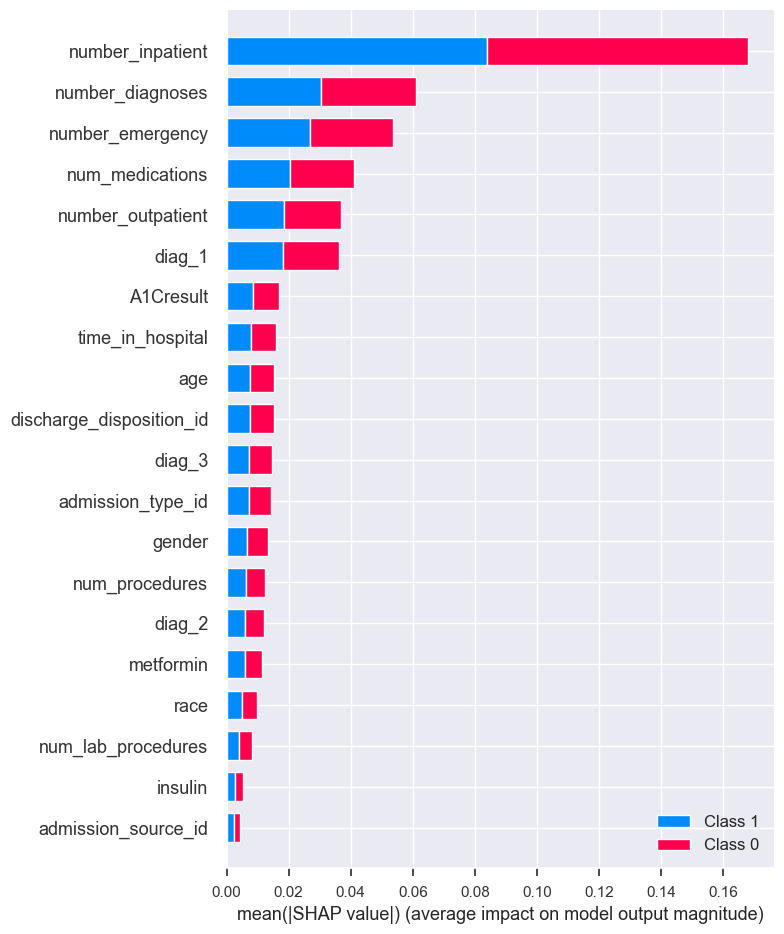

In [90]:
# Create a summary plot and set the feature names
shap.summary_plot(shap_values, X_test, show=False)

# Display the plot
plt.show()

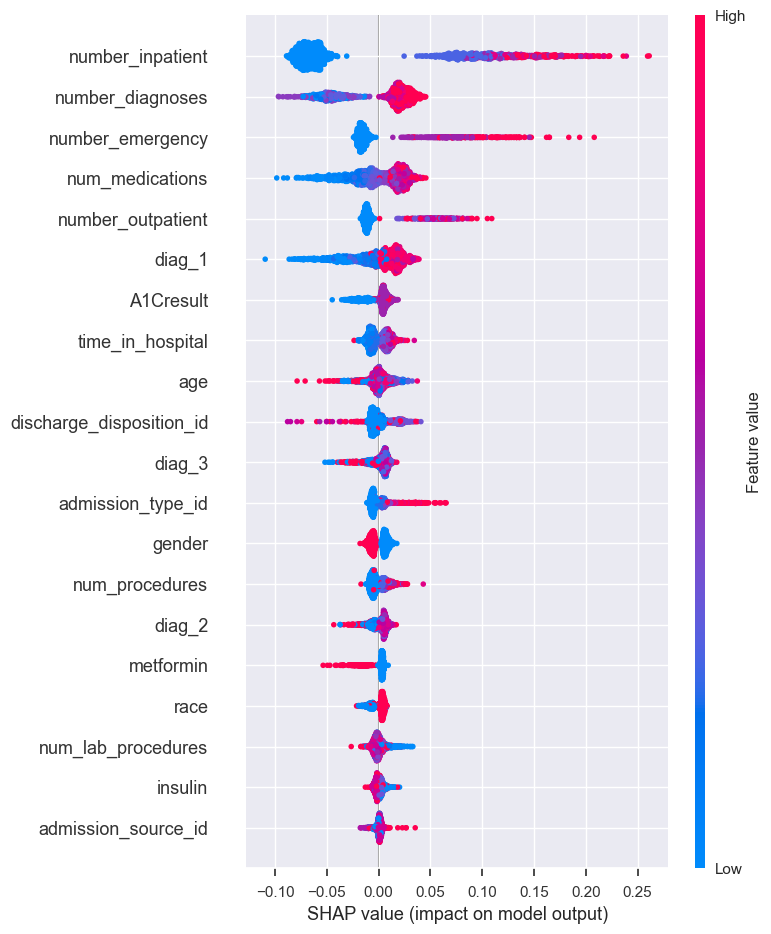

In [91]:
shap.summary_plot(shap_values[1], X_test)

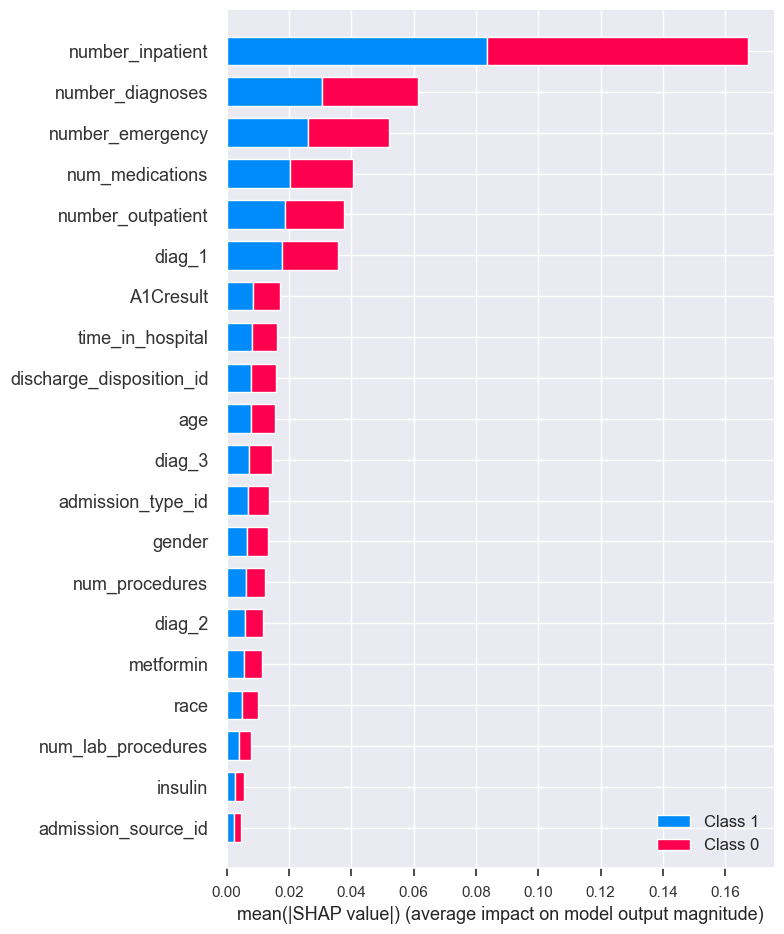

In [92]:
import shap


# Initialize the SHAP explainer with the model and training data
explainer = shap.TreeExplainer(rf_bal)
shap_values = explainer.shap_values(X_train)

# Summarize the SHAP values across the dataset for global feature importance
shap.summary_plot(shap_values, X_train, plot_type="bar")


### Top weights for each classifier, affecting the output

In [93]:
import eli5
eli5.show_weights(rf_bal, feature_names=X_train.columns.tolist())


Weight,Feature
0.2095 ± 0.1409,number_inpatient
0.0754 ± 0.0578,num_medications
0.0694 ± 0.0746,number_diagnoses
0.0671 ± 0.0497,diag_1
0.0653 ± 0.0753,number_emergency
0.0594 ± 0.0374,diag_3
0.0564 ± 0.0285,num_lab_procedures
0.0511 ± 0.0311,diag_2
0.0501 ± 0.0338,age
0.0433 ± 0.0540,number_outpatient


In [94]:
import eli5
eli5.show_weights(rf_bal_sub, feature_names=X_train.columns.tolist())


Weight,Feature
0.2102 ± 0.1415,number_inpatient
0.0750 ± 0.0594,num_medications
0.0711 ± 0.0762,number_diagnoses
0.0661 ± 0.0504,diag_1
0.0642 ± 0.0769,number_emergency
0.0608 ± 0.0393,diag_3
0.0563 ± 0.0286,num_lab_procedures
0.0520 ± 0.0324,diag_2
0.0491 ± 0.0331,age
0.0441 ± 0.0539,number_outpatient


### Reweighting 

In [95]:
import aif360

from aif360.datasets import StandardDataset
from sklearn.pipeline import make_pipeline 
from sklearn.pipeline import Pipeline

# Fairness metrics
from aif360.metrics import BinaryLabelDatasetMetric
from aif360.metrics import DatasetMetric

from aif360.metrics import ClassificationMetric

# Explainers
from aif360.explainers import MetricTextExplainer

# Scalers
from sklearn.preprocessing import StandardScaler

# Bias mitigation techniques
from aif360.algorithms.preprocessing import Reweighing
from aif360.algorithms.inprocessing import AdversarialDebiasing
from aif360.algorithms.inprocessing import PrejudiceRemover

# fairlearn libraries
from fairlearn.postprocessing import ThresholdOptimizer, plot_threshold_optimizer
from fairlearn.postprocessing._interpolated_thresholder import InterpolatedThresholder
from fairlearn.postprocessing._threshold_operation import ThresholdOperation

from fairlearn.reductions import (ExponentiatedGradient, 
                                  EqualizedOdds, 
                                  ErrorRateParity)

pip install 'aif360[LawSchoolGPA]'


In [96]:


# libraries for models
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# libraries for data processing
from sklearn import preprocessing
from sklearn.model_selection import train_test_split

# libraries for metrics of models
from sklearn.metrics import (
    accuracy_score, confusion_matrix,
    roc_curve, auc, roc_auc_score,
    plot_confusion_matrix,
    classification_report,
    balanced_accuracy_score,
    PrecisionRecallDisplay)

from sklearn.model_selection import GroupKFold
from sklearn.model_selection import cross_val_score

# libraries for fairness
from fairlearn.metrics import MetricFrame
from fairlearn.postprocessing import ThresholdOptimizer


from fairlearn.metrics import (
    MetricFrame,
    selection_rate, 
    demographic_parity_difference, 
    demographic_parity_ratio,
    false_positive_rate, 
    false_negative_rate,
    false_positive_rate_difference, 
    false_negative_rate_difference, 
    true_positive_rate, 
    true_negative_rate,
    selection_rate,
    count,
    equalized_odds_difference)
     



In [97]:
ds_aif = aif360.datasets.StandardDataset (diabetes_diag_df_, 
                                         label_name="readmitted_2_encoded",
                                         favorable_classes = [1], 
                                         protected_attribute_names=['race'], 
                                         privileged_classes= [lambda x: x == 2],
                                         )

In [98]:

# test, train split
ds_train, ds_test = ds_aif.split([0.80], shuffle=True)

In [99]:

# pre-processing - reweighing 
# define priviledged & unpriviledged groups
unpriv = [{'race': 3}, {'race': 1}]
priv = [{'race': 2}]

# for age change gender lavel to age 

# reweigh
RW = Reweighing (unprivileged_groups = unpriv, 
                 privileged_groups = priv)

RW_train = RW.fit_transform(ds_train)

In [100]:

# check for metric before and after transforming 
# OG ds
metric_train = BinaryLabelDatasetMetric(ds_train,
                                        unprivileged_groups = unpriv,
                                        privileged_groups = priv)

explainer_train = MetricTextExplainer(metric_train)

# transpormed ds
metric_transf_train = BinaryLabelDatasetMetric(RW_train,
                                               unprivileged_groups=unpriv,
                                               privileged_groups=priv)

explainer_transf_train = MetricTextExplainer(metric_transf_train)

In [101]:
# refit rfc model & get metrics
X_train = RW_train.features
y_train = RW_train.labels.ravel()
w_train = RW_train.instance_weights

X_test = ds_test.features
y_test = ds_test.labels.ravel()
     

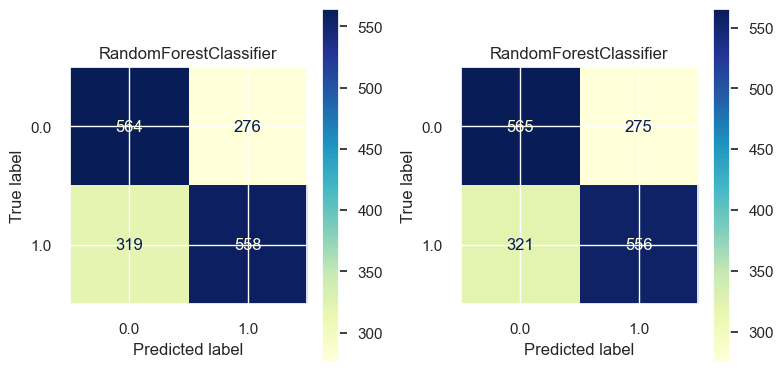

In [102]:

# test models with reweighted data
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(8, 4))

for cls, ax in zip(classifiers, axes.flatten()):
    dataset = RW_train
    cls.fit(dataset.features, dataset.labels.ravel(), sample_weight = dataset.instance_weights)
    
    plot_confusion_matrix(cls, 
                          X_test, 
                          y_test, 
                          ax=ax, 
                          cmap='YlGnBu')
    ax.title.set_text(type(cls).__name__)

plt.tight_layout()
plt.show()

In [103]:

for cls in classifiers:
  cls.fit(dataset.features, dataset.labels.ravel(), sample_weight = w_train)
  y_pred = cls.predict(X_test)
  
  print(f'{cls}: {chr(10)} {classification_report(y_test, y_pred)}')

RandomForestClassifier(class_weight='balanced_subsample', max_depth=9,
                       n_estimators=450, random_state=43): 
               precision    recall  f1-score   support

         0.0       0.64      0.67      0.65       840
         1.0       0.67      0.64      0.65       877

    accuracy                           0.65      1717
   macro avg       0.65      0.65      0.65      1717
weighted avg       0.65      0.65      0.65      1717

RandomForestClassifier(class_weight='balanced', max_depth=9, n_estimators=450,
                       random_state=43): 
               precision    recall  f1-score   support

         0.0       0.64      0.67      0.65       840
         1.0       0.67      0.63      0.65       877

    accuracy                           0.65      1717
   macro avg       0.65      0.65      0.65      1717
weighted avg       0.65      0.65      0.65      1717



In [104]:
# define test 
ds_test_pred = ds_test.copy(deepcopy=True)

In [105]:
for cls in classifiers:
    dataset = RW_train
    cls.fit(dataset.features, dataset.labels.ravel(), sample_weight=dataset.instance_weights)
    y_pred = cls.predict(X_test)

    # scores on test set
    ds_test_pred.scores = cls.predict_proba(X_test)[:, 1]

    # predictions (0 or 1) on test set
    y_train_pred = cls.predict(X_train)
    test_preds = (y_pred >= np.mean(y_train)) * 1

    models_dict = {"mitigated_pre-processing": (test_preds, y_pred)}

    print(f'Race:{chr(10)}{cls}: {chr(10)} {get_metrics_df(models_dict, y_test, race)} {chr(10)}')  # change age<> gender
    print(f'Race:{chr(10)}{cls}: {chr(10)} {metric_frame(race)} {chr(10)}')  # change age<> gender

    mf1 = MetricFrame(metrics=metrics,
                      y_true=y_test,
                      y_pred=y_pred,
                      sensitive_features=race)

    # The disaggregated metrics are stored in a pandas Series mf1.by_group:
    print(f"{cls}:\n {mf1.by_group}\n")
    print(f"{cls} difference:\n {mf1.difference(method='between_groups')}\n")

    # Calculate Equal Opportunity Differences
    tpr_race1 = metric_frame(race)["TPR"][1]  # TPR for race 1
    tpr_race2 = metric_frame(race)["TPR"][2]  # TPR for race 2
    tpr_race3 = metric_frame(race)["TPR"][3]  # TPR for race 3

    eod_race1_and_2 = tpr_race2 - tpr_race1
    eod_race3_and_2 = tpr_race2 - tpr_race3

    print(f"Equal Opportunity Difference between Races 1 and 2: {eod_race1_and_2}")
    print(f"Equal Opportunity Difference between Races 3 and 2: {eod_race3_and_2}")


Race:
RandomForestClassifier(class_weight='balanced_subsample', max_depth=9,
                       n_estimators=450, random_state=43): 
                                mitigated_pre-processing
Equalized_odds_difference                      0.538462
False negative rate difference                 0.152174
Balanced error rate difference                 0.233333
Demographic parity difference                  0.306122
  ------                                               
Overall AUC                                    0.653844
AUC difference                                 0.233333 

Race:
RandomForestClassifier(class_weight='balanced_subsample', max_depth=9,
                       n_estimators=450, random_state=43): 
            FPR       FNR       TPR       TNR
race                                        
0     0.337449  0.394191  0.605809  0.662551
1     0.000000  0.500000  0.500000  1.000000
2     0.312839  0.348409  0.651591  0.687161
3     0.538462  0.347826  0.652174  0.461538
4   

# UNAWARE MODEL

In [106]:

# set test & train data & defining age as sensitive attribute - UNAWARE

X = diabetes_diag_df_.drop(columns=['race','readmitted_2_encoded'])
y = diabetes_diag_df_['readmitted_2_encoded']

A = diabetes_diag_df_['race']


# for fairnes measures (inlc. A for group classification, drop age to make it unaware to other senstive attributes (fairnes through unawarenes)) - AGE 
X_train, X_test, y_train, y_test, A_train, A_test = train_test_split(
    X, 
    y, 
    A, 

    test_size = 0.20, 
    random_state=42)


from sklearn.metrics import accuracy_score, confusion_matrix

def demographic_parity(y_true, y_pred):
    return abs(sum(y_pred == 1) / len(y_pred) - sum(y_true == 1) / len(y_true))

def equal_opportunity(y_true, y_pred):
    tpr_pred = sum((y_true == 1) & (y_pred == 1)) / sum(y_true == 1)
    tpr_true = sum((y_true == 1) & (y_pred == 1)) / sum(y_true == 1)
    return abs(tpr_pred - tpr_true)

def statistical_parity(y_true, y_pred):
    return abs(sum(y_pred == 1) / len(y_pred) - sum(y_true == 1) / len(y_true))

for model in classifiers:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Calculate fairness metrics
    dp = demographic_parity(y_test, y_pred)
    eo = equal_opportunity(y_test, y_pred)
    sp = statistical_parity(y_test, y_pred)
    
    print(f"Fairness Metrics for {type(model).__name__}:")
    print(f"Demographic Parity: {dp:.4f}")
    print(f"Equal Opportunity: {eo:.4f}")
    print(f"Statistical Parity: {sp:.4f}")
    print()

Fairness Metrics for RandomForestClassifier:
Demographic Parity: 0.0169
Equal Opportunity: 0.0000
Statistical Parity: 0.0169

Fairness Metrics for RandomForestClassifier:
Demographic Parity: 0.0157
Equal Opportunity: 0.0000
Statistical Parity: 0.0157



In [107]:
from sklearn.model_selection import cross_val_predict, StratifiedKFold
from sklearn.metrics import classification_report, roc_auc_score



classifier_names = ["CatBoostClassifier", "RandomForestClassifier", "XGBoostClassifier"]

# Define the number of splits for cross-validation
n_splits = 4

# Loop over classifiers
for model, classifier_name in zip(classifiers, classifier_names):
    print(f"Evaluating {classifier_name}:")
    
    # Initialize lists to store classification reports and AUC scores
    classification_reports = []
    auc_scores = []
    
    # Perform cross-validation
    for train_index, test_index in StratifiedKFold(n_splits=n_splits).split(X_test, y_test):
        X_train_cv, X_test_cv = X_test.iloc[train_index], X_test.iloc[test_index]
        y_train_cv, y_test_cv = y_test.iloc[train_index], y_test.iloc[test_index]

        # Fit the model on the training data
        model.fit(X_train_cv, y_train_cv)

        # Make predictions on the test data
        y_pred_cv = model.predict(X_test_cv)

        # Predict probabilities for the 'Readmitted' class
        y_probs_cv = model.predict_proba(X_test_cv)[:, 1]

        # Compute the ROC-AUC score
        auc_cv = roc_auc_score(y_test_cv, y_probs_cv)
        auc_scores.append(auc_cv)

        # Generate and store the classification report
        report_cv = classification_report(y_test_cv, y_pred_cv, target_names=['Not Readmitted', 'Readmitted'], output_dict=True)
        classification_reports.append(report_cv)

    # Calculate the average AUC score across cross-validation folds
    avg_auc_score = sum(auc_scores) / len(auc_scores)
    
    # Calculate the average classification report across cross-validation folds
    avg_classification_report = {}
    for label in ['Not Readmitted', 'Readmitted']:
        avg_classification_report[label] = {
            'precision': sum(report[label]['precision'] for report in classification_reports) / len(classification_reports),
            'recall': sum(report[label]['recall'] for report in classification_reports) / len(classification_reports),
            'f1-score': sum(report[label]['f1-score'] for report in classification_reports) / len(classification_reports),
            'support': int(sum(report[label]['support'] for report in classification_reports) / len(classification_reports))
        }

    # Format and print the results
    print("Average Classification Report Unaware of Race:")
    for label in avg_classification_report:
        print(f"{label}:")
        for metric in avg_classification_report[label]:
            print(f"{metric}: {avg_classification_report[label][metric]:.2f}")
        print()
    print(f"Average AUC Score: {avg_auc_score:.2f}")
    print("\n")


Evaluating CatBoostClassifier:
Average Classification Report Unaware of Race:
Not Readmitted:
precision: 0.63
recall: 0.64
f1-score: 0.63
support: 209.00

Readmitted:
precision: 0.65
recall: 0.64
f1-score: 0.65
support: 220.00

Average AUC Score: 0.71


Evaluating RandomForestClassifier:
Average Classification Report Unaware of Race:
Not Readmitted:
precision: 0.63
recall: 0.64
f1-score: 0.63
support: 209.00

Readmitted:
precision: 0.65
recall: 0.64
f1-score: 0.65
support: 220.00

Average AUC Score: 0.71




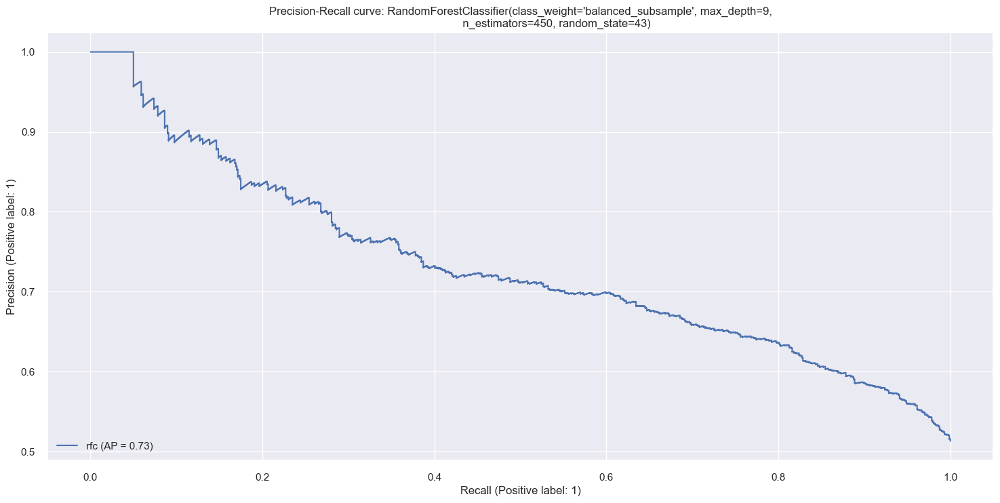

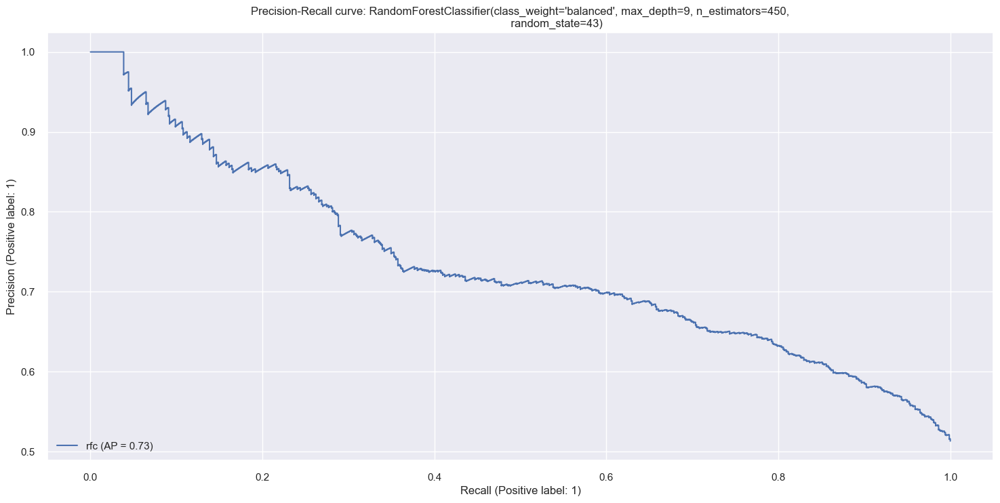

In [108]:
for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)
  display = PrecisionRecallDisplay.from_estimator(model, X_test, y_test, name="rfc")
  _ = display.ax_.set_title(f'Precision-Recall curve: {model}')  

In [109]:
# define sensitive attributes
race =  A_test


for model in classifiers:
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  # scores on test set
  y_pred = model.predict_proba(X_test)[:, 1]

  # predictions (0 or 1) on test set
  test_preds = (y_pred >= np.mean(y_train)) * 1

  print(f'Race-Model is Unaware:{chr(10)}{model}: {chr(10)} {metric_frame (race)} {chr(10)}')

Race-Model is Unaware:
RandomForestClassifier(class_weight='balanced_subsample', max_depth=9,
                       n_estimators=450, random_state=43): 
            FPR       FNR       TPR       TNR
race                                        
0     0.285156  0.364035  0.635965  0.714844
1     0.333333  0.000000  1.000000  0.666667
2     0.359551  0.331169  0.668831  0.640449
3     0.285714  0.238095  0.761905  0.714286
4     0.500000  0.533333  0.466667  0.500000 

Race-Model is Unaware:
RandomForestClassifier(class_weight='balanced', max_depth=9, n_estimators=450,
                       random_state=43): 
            FPR       FNR       TPR       TNR
race                                        
0     0.277344  0.368421  0.631579  0.722656
1     0.333333  0.000000  1.000000  0.666667
2     0.357678  0.329545  0.670455  0.642322
3     0.321429  0.238095  0.761905  0.678571
4     0.500000  0.466667  0.533333  0.500000 



In [110]:
# Define sensitive attributes
race = A_test

# Initialize lists to store the differences
difference_race1_and_2 = []
difference_race3_and_2 = []

# Metrics 
for model in classifiers:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # scores on test set
    y_pred = model.predict_proba(X_test)[:, 1]

    # predictions (0 or 1) on test set
    test_preds = (y_pred >= np.mean(y_train)) * 1

    models_dict = {"Unaware": (test_preds, y_pred)}

    # Calculate the TPR for each race group
    tpr_race1 = metric_frame(race)["TPR"][1]  # TPR for race 1
    tpr_race2 = metric_frame(race)["TPR"][2]  # TPR for race 2
    tpr_race3 = metric_frame(race)["TPR"][3]  # TPR for race 5

    # Calculate and store the differences
    diff1_and_2 = tpr_race2 - tpr_race1
    diff3_and_2 = tpr_race2 - tpr_race3

    difference_race1_and_2.append(diff1_and_2)
    difference_race3_and_2.append(diff3_and_2)

    print(f'Race:{chr(10)}{model}: {chr(10)} {get_metrics_df(models_dict, y_test, race)} {chr(10)}') 

    # Calculate Equal Opportunity Differences for the current classifier
    eod_race1_and_2 = diff1_and_2
    eod_race3_and_2 = diff3_and_2

    print(f'Equal Opportunity Difference between Races 1 and 2: {eod_race1_and_2}')
    print(f'Equal Opportunity Difference between Races 3 and 2: {eod_race3_and_2}')



Race:
RandomForestClassifier(class_weight='balanced_subsample', max_depth=9,
                       n_estimators=450, random_state=43): 
                                  Unaware
Equalized_odds_difference       0.533333
False negative rate difference  0.533333
Balanced error rate difference      0.35
Demographic parity difference   0.096646
  ------                                
Overall AUC                     0.722901
AUC difference                  0.261111 

Equal Opportunity Difference between Races 1 and 2: -0.3311688311688312
Equal Opportunity Difference between Races 3 and 2: -0.09307359307359309
Race:
RandomForestClassifier(class_weight='balanced', max_depth=9, n_estimators=450,
                       random_state=43): 
                                  Unaware
Equalized_odds_difference       0.466667
False negative rate difference  0.466667
Balanced error rate difference  0.316667
Demographic parity difference   0.096646
  ------                                
Overall AUC  